In [1]:
import os
import cv2
import pycolmap
from hloc.utils import viz_3d
import numpy as np
import pixtrack.utils.pose_utils as pose_utils
from pixloc.utils.colmap import Camera as ColCamera
from pixloc.pixlib.geometry import Camera as PixCamera, Pose
import matplotlib.pyplot as plt
from pixtrack.utils.ingp_utils import load_nerf2sfm, initialize_ingp, sfm_to_nerf_pose, nerf_to_sfm_pose
from pixtrack.visualization.run_vis_on_poses import get_nerf_image
from scipy.spatial.transform import Rotation as R

In [2]:
from pixtrack.utils.ingp_utils import get_nerf_aabb_from_sfm

In [3]:
import math

def get_nerf_depth_image(testbed, nerf_pose, camera):
    spp = 8
    width, height = camera.size
    width = int(width)
    height = int(height)
    fl_x = float(camera.f[0])
    angle_x = math.atan(width / (fl_x * 2)) * 2

    testbed.fov = angle_x * 180 / np.pi
    testbed.set_nerf_camera_matrix(nerf_pose[:3, :])
    testbed.render_mode = testbed.render_mode.Depth

    nerf_img = testbed.render(width, height, spp, True)
    #nerf_img = nerf_img[:, :, :3] * 255.
    #nerf_img = nerf_img.astype(np.uint8)
    testbed.render_mode = testbed.render_mode.Shade
    return nerf_img

def get_nerf_image(testbed, nerf_pose, camera):
    spp = 8
    width, height = camera.size
    width = int(width)
    height = int(height)
    fl_x = float(camera.f[0])
    angle_x = math.atan(width / (fl_x * 2)) * 2

    testbed.fov = angle_x * 180 / np.pi
    testbed.set_nerf_camera_matrix(nerf_pose[:3, :])

    nerf_img = testbed.render(width, height, spp, True)
    nerf_img = nerf_img[:, :, :3] * 255.
    nerf_img = nerf_img.astype(np.uint8)
    return nerf_img


def get_nerf_normals_image(testbed, nerf_pose, camera):
    spp = 8
    width, height = camera.size
    width = int(width)
    height = int(height)
    fl_x = float(camera.f[0])
    angle_x = math.atan(width / (fl_x * 2)) * 2

    testbed.fov = angle_x * 180 / np.pi
    testbed.set_nerf_camera_matrix(nerf_pose[:3, :])
    testbed.render_mode = testbed.render_mode.Normals

    nerf_img = testbed.render(width, height, spp, True)
    #nerf_img = nerf_img[:, :, :3] * 255.
    #nerf_img = nerf_img.astype(np.uint8)
    testbed.render_mode = testbed.render_mode.Shade
    return nerf_img

In [4]:
sfm_path = '/home/wayve/saurabh/pixtrack/data/035_power_drill/pixtrack/aug_nerf_sfm/ref/'
model = pycolmap.Reconstruction(sfm_path)


nerf_path = '/home/wayve/saurabh/pixtrack/data/035_power_drill/pixtrack/instant-ngp/snapshots/weights.msgpack'
nerf2sfm_path = '/home/wayve/saurabh/pixtrack/data/035_power_drill/pixtrack/pixsfm/dataset/nerf2sfm.pkl'
nerf2sfm = load_nerf2sfm(nerf2sfm_path)
aabb = get_nerf_aabb_from_sfm(sfm_path, nerf2sfm_path)
testbed = initialize_ingp(nerf_path, aabb=aabb)#, aabb=aabb_with_table)

19:25:03 INFO     Loading network config from: /home/wayve/saurabh/pixtrack/data/035_power_drill/pixtrack/instant-ngp/snapshots/weights.msgpack
19:25:03 INFO     GridEncoding:  Nmin=16 b=1.51572 F=2 T=2^19 L=16
19:25:03 INFO     Density model: 3--[HashGrid]-->32--[FullyFusedMLP(neurons=64,layers=3)]-->1
19:25:03 INFO     Color model:   3--[Composite]-->16+16--[FullyFusedMLP(neurons=64,layers=4)]-->3
19:25:03 INFO       total_encoding_params=13074912 total_network_params=10240


In [5]:
from pixloc.pixlib.geometry import Camera, Pose
import scipy.ndimage as ndimage


In [6]:
point_ids = []
points3d_in_sfm = []
for point_id in model.points3D:
    point_ids.append(point_id)
    points3d_in_sfm.append(model.points3D[point_id].xyz)

points3d_in_sfm = np.array(points3d_in_sfm)
points3d_in_sfm = np.hstack((points3d_in_sfm, np.ones((points3d_in_sfm.shape[0], 1))))

camera = model.cameras[1]
cIw = pose_utils.get_camera_in_world_from_colmap_image(model.images[90])

camera = ColCamera(
    cIw, 
    camera.model_name,
    int(camera.width),
    int(camera.height),
    camera.params
)
f, cy, cx, d  = camera.params.tolist()
camera = PixCamera.from_colmap(camera)
camera = camera.scale(1.0)


In [293]:
cIw = pose_utils.get_camera_in_world_from_colmap_image(model.images[90])
sfm_in_camera = np.linalg.inv(cIw)
nerf_pose = sfm_to_nerf_pose(nerf2sfm, cIw)
depth_image = get_nerf_depth_image(testbed, nerf_pose, camera)
nerf_rgb_img = get_nerf_image(testbed, nerf_pose, camera)
normals_image = get_nerf_normals_image(testbed, nerf_pose, camera)[..., :3]
#normals_image = ndimage.gaussian_filter(normals_image, sigma=(5, 5, 0), order=0)


In [8]:
import torchvision
import torch
#blur = torchvision.transforms.GaussianBlur(kernel_size=3)
#normals_image = blur(torch.Tensor(normals_image)).cpu().numpy()

In [154]:
def mask_depth_image(nerf_depth_img: np.ndarray, mask_edge: int=500, mask_value: float = 0.1):
    rows, columns, depths = nerf_depth_img.shape
    row_corner = int(rows/2) - 500
    column_corner = int(columns/2) - 500 
    curr_depth = nerf_depth_img.copy()
    curr_depth[row_corner: row_corner + mask_edge, column_corner: column_corner + mask_edge, :3] = mask_value
    return curr_depth

In [155]:
#mask_depth_image = mask_depth_image(nerf_depth_img)

In [11]:
import time
#!pip3 install --upgrade open3d --quiet

#import open3d as o3d
#from open3d.j_visualizer import JVisualizer

In [157]:
#pcd = o3d.geometry.PointCloud()
#pcd.points = o3d.utility.Vector3dVector(points3d_in_sfm[:, :3])
#o3d.visualization.draw_geometries([pcd])
#visualizer = o3d.JVisualizer()

In [464]:
def get_visible_indices(
    nerf2sfm, points3d_in_sfm, sfm_in_camera, depth_image, normals_image, 
    min_depth_threshold=1e-2, alpha_threshold=0.5, depth_closeness_threshold=1e-3
):
    """
    
    Args:
        min_depth_threshold: minimum depth of any point. Depth lower than this is considered noise
        alpha_threshold: Threshold over the visibility of the point
        depth_closeness_threshold: The threshold to decide whether a 3d point is visible in the image using depth
    """
    points3d_in_sfm_camera_frame = np.dot(
        sfm_in_camera, points3d_in_sfm.T
    ).T[:, :-1]
    #normals_in_camera = np.hstack((normals_image, np.ones((normals_image.shape[0], 1))))
    
    #normals_in_camera_frame = sfm_in_camera @ normals_in_camera
    pts_in_image = camera.world2image(points3d_in_sfm_camera_frame)
    project_image_points = pts_in_image[0].cpu().numpy()
    nerf2sfm_scale = nerf2sfm["avglen"] / 3.0 
    sfm_pts_in_nerf = points3d_in_sfm_camera_frame  
    depths_at_points = depth_image[
        project_image_points[:, 1].astype(int), project_image_points[:, 0].astype(int), 0]
    alphas_at_points = depth_image[
        project_image_points[:, 1].astype(int), project_image_points[:, 0].astype(int), -1]

    ray_directions = -points3d_in_sfm_camera_frame / np.linalg.norm(points3d_in_sfm_camera_frame, axis=1)[:,np.newaxis]
    #import pdb; pdb.set_trace()
    normals_in_camera = normals_image[project_image_points[:, 1].astype(int), project_image_points[:, 0].astype(int), :3]
    normals_in_camera = normals_in_camera / (np.linalg.norm(normals_in_camera, axis=1) + 1e-6)[:,np.newaxis]
    
    
    new_arr = np.empty_like(normals_in_camera)
    new_arr[:,  0] = normals_in_camera[:, 0]
    new_arr[:,  1] = -normals_in_camera[:, 1]

    new_arr[:, 2] = -normals_in_camera[:, 2]
    print(ray_directions.shape, normals_in_camera.shape)
    visibility_angle = np.sum(new_arr * (ray_directions), axis=1)
    print(visibility_angle.min(), visibility_angle.max())
    #import pdb; pdb.set_trace()
    #print(visibility_angle)
    depths_at_points *= nerf2sfm_scale
    visible_indices = np.where(
        (depths_at_points >= min_depth_threshold) &\
        (visibility_angle >= 0.4) &\
        (alphas_at_points >= alpha_threshold) & \
        np.isclose(sfm_pts_in_nerf[:, 2], depths_at_points, atol=depth_closeness_threshold)
    )[0]
    return visible_indices, normals_in_camera

In [465]:
np.linalg.norm(normals_image, axis=1).min()

0.0

In [466]:
t = time.time()
visible_indices, normals = get_visible_indices(nerf2sfm, points3d_in_sfm, sfm_in_camera, depth_image, normals_image)
print(time.time() - t)
#point_ids = np.array(point_ids)[visible_indices]

(14109, 3) (14109, 3)
-0.32778354427073375 0.8806808694339192
0.006382465362548828


In [467]:
visible_indices.shape

(1344,)

In [468]:
nerf2sfm_scale = nerf2sfm["avglen"] / 3.0 
sfm_pts_in_nerf = points3d_in_sfm_camera_frame  
pts_in_image = camera.world2image(points3d_in_sfm_camera_frame)
project_image_points = pts_in_image[0].cpu().numpy()
depths_at_points_in_sfm = depth_image 
points_lifted_from_depth = []
for pt in project_image_points:
    depth_at_point = depths_at_points_in_sfm[int(pt[1]), int(pt[0])][0]
    point_from_depth = [
        (pt[0].item() - cx) * depth_at_point/ f, (pt[1].item() - cy) * depth_at_point/ f, depth_at_point
    ]
    points_lifted_from_depth.append(point_from_depth)
points_lifted_from_depth = np.array(points_lifted_from_depth) * nerf2sfm_scale

In [469]:
points_lifted_from_depth.min(axis=0)

array([-0.07737615, -0.07093269,  0.        ])

In [470]:
points3d_in_sfm_camera_frame.min(axis=0)

array([-0.08159074, -0.07334341,  0.20928067])

In [471]:
f, cy, cx, d

(2700.0, 1536.0, 1536.0, 0.0)

In [472]:
pts_from_sfm_with_ids = []
for point_id in model.points3D:
    if point_id in visible_indices:
        pts_from_sfm_with_ids.append(model.points3D)


In [473]:
import plotly.graph_objects as go

fig = go.Figure(
    data=[
        #go.Scatter3d(
        #    x=points3d_in_sfm_camera_frame[:, 0], y=points3d_in_sfm_camera_frame[:, 1], z=points3d_in_sfm_camera_frame[:, 2],
        #    mode='markers', marker=dict(
        #    size=2,
        #    colorscale='Viridis',   # choose a colorscale
        #    opacity=0.8)),
          
        go.Scatter3d(
            x=points_lifted_from_depth[:, 0], y=points_lifted_from_depth[:, 1], z=points_lifted_from_depth[:, 2],
            mode='markers', marker=dict(
            size=2,
            colorscale='sunset',   # choose a colorscale
            opacity=0.8)
        ),
        go.Scatter3d(
            x=points3d_in_sfm_camera_frame[visible_indices, 0], y=points3d_in_sfm_camera_frame[visible_indices, 1], z=points3d_in_sfm_camera_frame[visible_indices, 2],
            mode='markers', marker=dict(
            size=2,
            colorscale='gray',   # choose a colorscale
            opacity=0.8)
        )
    ]
)
fig.update_layout(scene_aspectmode='auto')
fig.show()

In [474]:
points_lifted_from_depth

array([[-0.02358261, -0.04150644,  0.22121239],
       [-0.04651354, -0.02978706,  0.21519149],
       [ 0.04947347, -0.0619306 ,  0.24999475],
       ...,
       [ 0.05932608, -0.06890238,  0.25938176],
       [ 0.05650499, -0.06962475,  0.26103956],
       [ 0.06006625, -0.06878067,  0.25889161]])

In [475]:
points3d_in_sfm_camera_frame = np.dot(
    sfm_in_camera, points3d_in_sfm.T
).T[:, :-1]
pts_in_image = camera.world2image(points3d_in_sfm_camera_frame)[0].cpu().numpy()
visible_image_pts = pts_in_image[visible_indices]

In [476]:
nerf_rgb_img_c = nerf_rgb_img.copy()
for pt in visible_image_pts:
    nerf_rgb_img_c = cv2.circle(
        nerf_rgb_img_c, center=(int(pt[0]),int(pt[1])), radius=5, color=(0, 255, 0), thickness=-1)

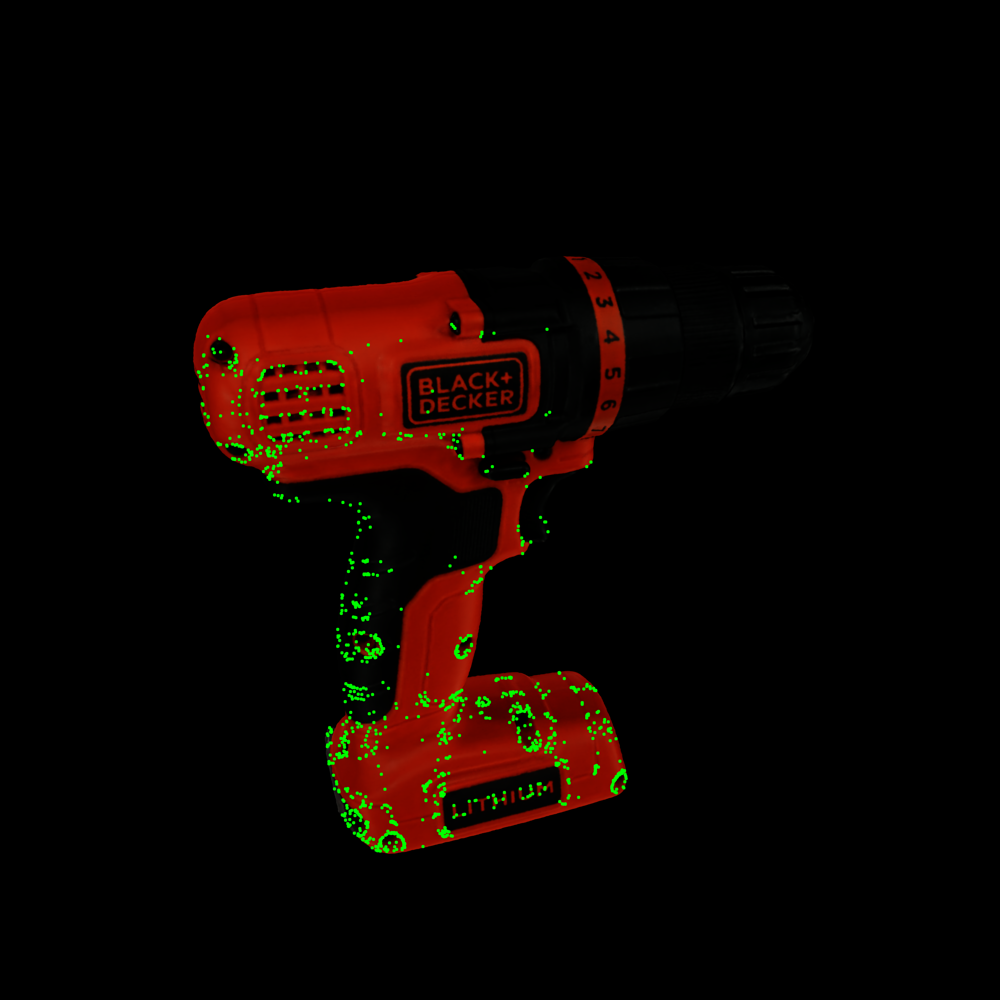

In [477]:
from PIL import Image
Image.fromarray(nerf_rgb_img_c)

In [478]:
from PIL import Image
Image.fromarray((mask_depth_image[:, :, 0]*255.0 / np.max(mask_depth_image[:, :, 0])).astype(np.uint8))

NameError: name 'mask_depth_image' is not defined

In [479]:
import plotly.express as px
normalized_vals = np.repeat(np.expand_dims(np.linalg.norm(normals_image, axis=2) + 1e-6, axis=2), axis=2, repeats=3)
normals_image = normals_image[:, :, :3] / normalized_vals




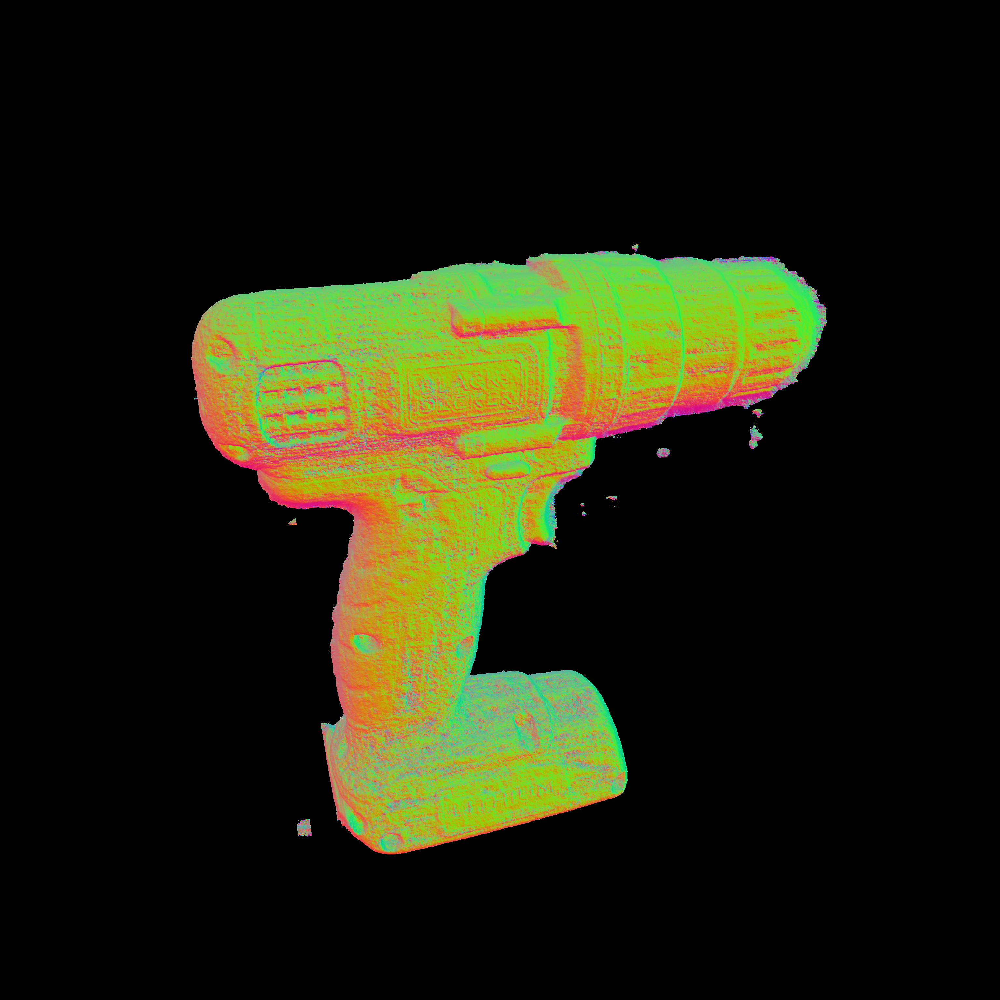

In [480]:
fig = px.imshow(normals_image)
fig.show()

In [244]:
print(normals_image[1211, 1764]) # -x like
print(normals_image[1231, 2155]) # - y like
print(normals_image[1223, 974]) # - y like

print(normals_image[1260, 1062], "in") # - y like
print(normals_image[1193, 944], "out") # - y like

[0.8865197  0.42261335 0.18835793]
[0.9184601  0.25825682 0.29955116]
[0.44966432 0.8376321  0.31011733]
[0.8819478 0.2997541 0.3637492] in
[0.8374924  0.37094867 0.4012469 ] out


In [254]:
sfm_in_camera

(14109, 4)

In [483]:
subsampled_indices = visible_indices
fig = go.Figure(data=[
    go.Cone(
        x=points3d_in_sfm_camera_frame[subsampled_indices, 0], 
        y=points3d_in_sfm_camera_frame[subsampled_indices, 1], 
        z=points3d_in_sfm_camera_frame[subsampled_indices, 2], 
        u=5*normals[subsampled_indices, 0], v=-5*normals[subsampled_indices, 2], w=-5*normals[subsampled_indices, 1]),
    go.Scatter3d(
        x=points3d_in_sfm_camera_frame[subsampled_indices, 0], 
        y=points3d_in_sfm_camera_frame[subsampled_indices, 1], 
        z=points3d_in_sfm_camera_frame[subsampled_indices, 2],
        mode='markers', marker=dict(
        size=2,
        colorscale='gray',   # choose a colorscale
        opacity=0.8)
    )]
)
fig.show()


In [262]:
visible_indices

array([   27,    28,    30, ..., 13847, 13851, 14079])


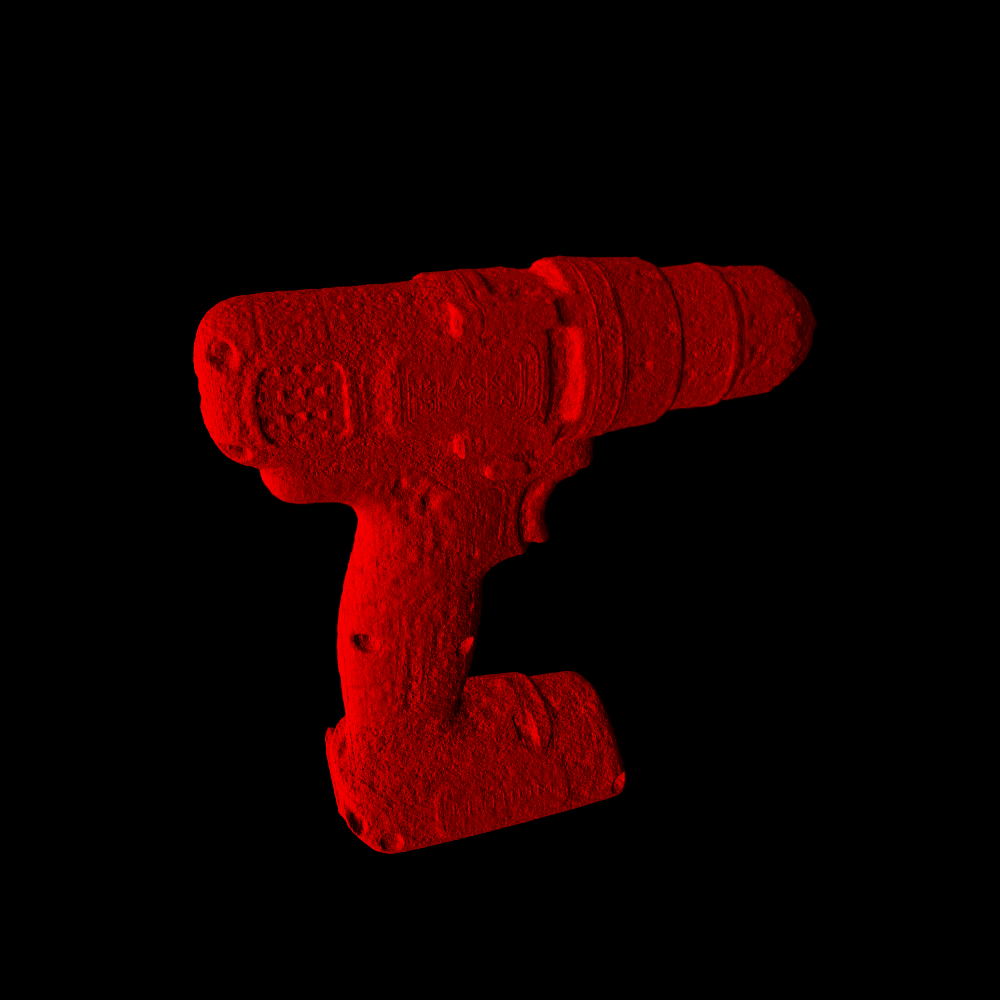

In [324]:
nrms = normals_image[:, :, :3]


shape_ = nrms.shape
nrms = nrms.reshape(shape_[0]*shape_[1], 3)

new_arr = np.empty_like(nrms)
new_arr[:, 0] = nrms[:, 0]
new_arr[:, 1] = -nrms[:, 2]

new_arr[:, 2] = -nrms[:, 1]
new_arr = new_arr + new_arr.min(axis=0)
#print(np.linalg.norm(new_arr, axis=1).shape, "norm")

#new_arr /= (np.linalg.norm(new_arr, axis=1) + 1e-6)
#new_arr1 /= new_arr.max(axis=0)
#import pdb; pdb.set_trace()

new_arr = new_arr.reshape((shape_[0], shape_[1], 3))

fig = px.imshow(new_arr)
fig.show()


In [330]:
print(new_arr[1133, 1773]/ np.linalg.norm(new_arr[1133, 1773]))

print(new_arr[1240, 639]/ np.linalg.norm(new_arr[1240, 639]))

print(new_arr[1288, 1307]/ np.linalg.norm(new_arr[1288, 1307]))

[ 0.4268147  -0.53362656 -0.73011774]
[ 0.4107972  -0.5311011  -0.74106497]
[ 0.31419396 -0.5309801  -0.786983  ]


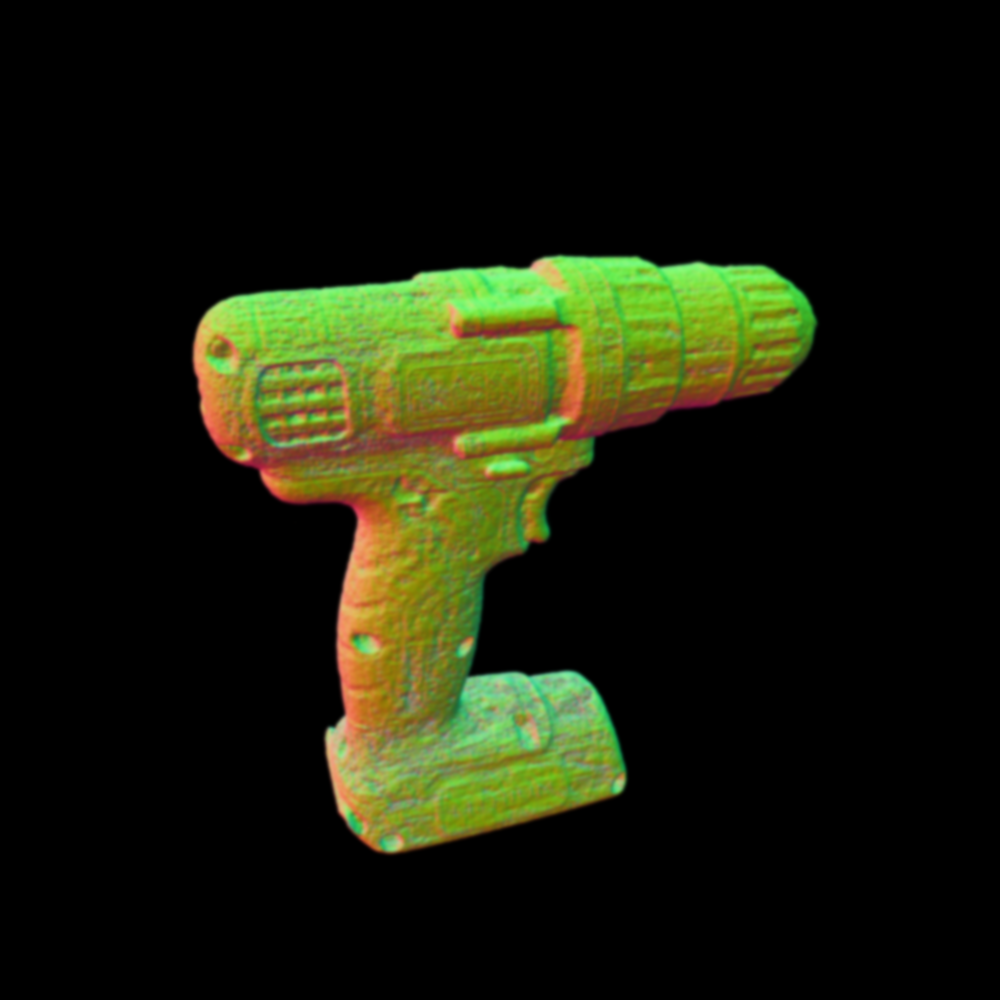

In [32]:
Image.fromarray((normals_image_smooth[:, :, :3] * 255).astype(np.uint8))